# Demo: Geo Mapping with Plotly - **SWISS Municipalities** Choropleth Maps

The process of producing visual representations of geographic data, frequently on a map or in another geographical context, is referred to as **geo-mapping**. Depending on their geographic coordinates, points, lines, or **areas** can be displayed on a map.

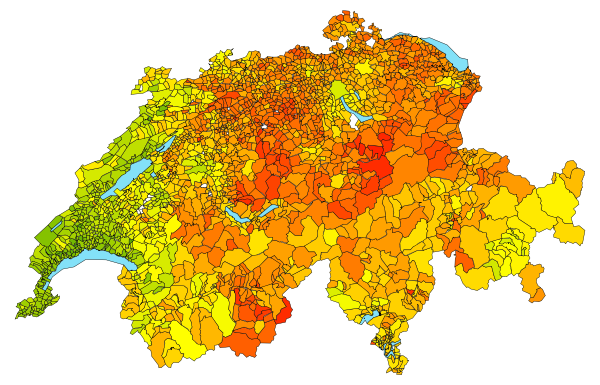

## Choropleth Map
[Choropleth Maps](https://datavizcatalogue.com/methods/choropleth.html) display divided **geographical areas or regions that are coloured, shaded or patterned in relation to a data variable**. This provides a way to visualise values over a geographical area, which can show variation or patterns across the displayed location.

The **data variable** uses colour progression to represent itself in each region of the map. Typically, this can be a blending from one colour to another, a single hue progression, transparent to opaque, light to dark or an entire colour spectrum.

> One downside to the use of colour is that *you can't accurately read or compare values from the map*.   
> Another issue is that larger regions appear more emphasised then smaller ones, so the viewer's perception of the shaded values are affected.  
> A common error when producing Choropleth Maps is to encode raw data values (such as population) rather than using normalized values (calculating population per square kilometre for example) to produce a density map.

## Plotly
**Plotly** is an open source library for Python. It integrates greatly with Jupyter Notebook and Dash to create interactive content for websites. It can be used to create ad hoc charts and professional content.

Handling spatial data for Geo Mapping needs some additional datasets and basic setup before you can use it for visual data representation and analysis.

E.g.Choropleth Charts are colored shapes and those shapes are of course manyfold. If you read through [Plotly Documentation](https://plotly.com/python/choropleth-maps/) you can see that there are default shapes available in plotly for USA States and Countries as defined in the Natural Earth datasets.

To visualize data for Switzerland geo regions like **cantons**, **districts** or **municipalities**, we must explore other data sources for corresponding shapes to handle with.

---   
Source/Links:   
+ [Choropleth Mapping](https://geographicdata.science/book/notebooks/05_choropleth.html)
+ [Cartography - Choropleth Maps](https://storymaps.arcgis.com/collections/bc79ea24ec354f77bfa7616b247ac986?item=3)
+ [Introduction to Cartography - Choropleth Maps](https://alg.manifoldapp.org/read/introduction-to-cartography/section/c3c06272-8b8b-49e7-a957-da0d06550b73#3-part-1)
+ [Datawrapper Academy - Choropleth  Maps](https://academy.datawrapper.de/category/93-maps)  
<br>  
+ [Geo Data + GeoJSON](https://handsondataviz.org/geojson.html)
+ [GeoJSON and JavaScript: A Developer's Handbook for Geographic Data](https://www.geoapify.com/geojson-javascript-developer-guide)
+ [Download GeoJSON Countries of the World](https://geojson-maps.kyd.au/)
+ [geojson.io](https://geojson.io/#map=2/0/20) a quick, simple tool for creating, viewing, and sharing spatial data
+ Find [GeoJSON Boundary Files](https://handsondataviz.org/find-geojson.html) in "Hands-On Data Visualization" from O'Reilly

History:       
+ March 2024, v1, dbe --- initial version for BINA FS24

---  

---  
## **Example:** Swiss Choropleth Plot Map using **Swiss Municipalities** GeoFrame and BFS DataFrame

### 1) Load the **Swiss Municipalities** raw GeoData and Pre-Process the corresponding **`geodf` GeoFrame**

In [1]:
import pandas as pd

# Load GEOPANDAS library
import geopandas as gpd

In [18]:
# read Swiss Cantons Geometry Data (as GeoFrame)
geofilePATH = 'https://raw.githubusercontent.com/sawubona-repo/BINA-FS24-WORK/master/zDiversExamples/Notebook-GeoMapping/DATA/'
geofileNAME = 'ch-municipalities-new.geojson'

# Read GeoJSON geometry data into geopandas GeoDataFrame
raw_geodf = gpd.read_file(geofilePATH+geofileNAME)

raw_geodf.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 2119 entries, 0 to 2118
Data columns (total 5 columns):
 #   Column        Non-Null Count  Dtype   
---  ------        --------------  -----   
 0   GemeindeNr    2119 non-null   int64   
 1   GemeindeName  2119 non-null   object  
 2   KantonKürzel  2119 non-null   object  
 3   KantonName    2119 non-null   object  
 4   geometry      2119 non-null   geometry
dtypes: geometry(1), int64(1), object(3)
memory usage: 82.9+ KB


In [19]:
raw_geodf.head()

,GemeindeNr,GemeindeName,KantonKürzel,KantonName,geometry
0,1,Aeugst am Albis,ZH,Zürich,"MULTIPOLYGON Z (((8.50388 47.27308 720.72250, ..."
1,2,Affoltern am Albis,ZH,Zürich,"MULTIPOLYGON Z (((8.41466 47.29360 463.84375, ..."
2,3,Bonstetten,ZH,Zürich,"MULTIPOLYGON Z (((8.44132 47.31583 579.46875, ..."
3,4,Hausen am Albis,ZH,Zürich,"MULTIPOLYGON Z (((8.57437 47.21707 545.69750, ..."
4,5,Hedingen,ZH,Zürich,"MULTIPOLYGON Z (((8.43621 47.31520 609.31500, ..."


---  

> Use the following code sequence if you like to **reduce the entire CH municipality geoframe to your specific selection of municipalities** from one or more cantons


#### a) Generate the List of Cantons, included in the CH Municipalities Geo Data Set and define a suitable subset for further geomappings

In [4]:
# Show the (2 char) KantonsKürzel of the Swiss cantons in the GeoFrame
print(raw_geodf.KantonKürzel.unique())
print(raw_geodf.KantonKürzel.nunique())

ch_cantons = pd.Series(raw_geodf.KantonKürzel.unique())
# ch_cantons.info()

['ZH' 'BE' 'LU' 'UR' 'SZ' 'OW' 'NW' 'GL' 'ZG' 'FR' 'SO' 'BS' 'BL' 'SH'
 'AR' 'AI' 'SG' 'GR' 'AG' 'TG' 'TI' 'VD' 'VS' 'NE' 'GE' 'JU']
26


##### **Var 1**: Define a selection of cantons (`ch_selection`) by removing a subset (`excl_cantons`) from the whole list of cantons (`ch_cantons`)

In [20]:
excl_cantons = pd.Series(['LU','UR','SZ','OW','NW','GL'])

ch_selection = ch_cantons[~ch_cantons.isin(excl_cantons)]

ch_selection

0     ZH
1     BE
8     ZG
9     FR
10    SO
11    BS
12    BL
13    SH
14    AR
15    AI
16    SG
17    GR
18    AG
19    TG
20    TI
21    VD
22    VS
23    NE
24    GE
25    JU
dtype: object

##### **Var 2**: Define explicitely a subset of cantons (`ch_selection`) by using the `KantonKürzel`values

In [21]:
# Define your specific cantons list (e.g. central swiss)
ch_subset = ['LU','UR','SZ','OW','NW','GL']


#### b) Generate a new geoFrame where only the geometry data of  the selected cantons are included

In [22]:
# choose the appropriate filter for a subset of CH municipalities
# geo_filter = ch_selection         # var 1
geo_filter = ch_subset              # var 2

In [23]:
# Define a new geoFrame containing the municipalities of the defined list of cantons
geodf_filtered = raw_geodf[raw_geodf.KantonKürzel.isin(geo_filter)]

print(geodf_filtered.KantonKürzel.unique())
geodf_filtered.head()

['LU' 'UR' 'SZ' 'OW' 'NW' 'GL']


,GemeindeNr,GemeindeName,KantonKürzel,KantonName,geometry
494,1001,Doppleschwand,LU,Luzern,"MULTIPOLYGON Z (((8.05803 47.02880 604.60250, ..."
495,1002,Entlebuch,LU,Luzern,"MULTIPOLYGON Z (((8.08585 46.90607 1911.16250,..."
496,1004,Flühli,LU,Luzern,"MULTIPOLYGON Z (((8.04694 46.78711 2349.03000,..."
497,1005,Hasle,LU,Luzern,"MULTIPOLYGON Z (((8.06213 46.90957 1927.70375,..."
498,1007,Romoos,LU,Luzern,"MULTIPOLYGON Z (((8.05803 47.02880 604.60250, ..."


#### c) **Optional**: Store the reduced geoFrame as geojson object for further processing with choropleth geomaps

> Note: the new generated geojson file will be store in your local colab filesystem. *You need to download this file* before leaving your colab runtime environment. Otherwise your data will be deleted.

In [24]:
# Store filtered GeoFrame for further mappings or visualizations

selGEOFILE = 'ch-CENTRAL-municipalities.geojson'
geodf_filtered.to_file(selGEOFILE, driver='GeoJSON')

---  
### 2) Load the **Swiss Federal Statistics (BFS)** raw Data and Pre-Process the correspnding **`bfsdf` DataFrame**

> See [*BFS*](https://www.bfs.admin.ch/bfs/de/home/statistiken/regionalstatistik/regionale-portraets-kennzahlen/gemeinden/daten-erlaeuterungen.assetdetail.15864450.html) *Regionalporträts 2021: Kennzahlen aller Gemeinden* for the original data source

In [ ]:
# read BFS Gemeindedaten
bfsfilePATH = 'https://raw.githubusercontent.com/sawubona-repo/BINA-FS24-WORK/main/zDiversExamples/DATA/BFS/'
bfsfileNAME = 'BFS_CH-Gemeinden-Kennzahlen-NEW-2021.csv'
raw_bfs_file = bfsfilePATH + bfsfileNAME

# Read CSV file into DataFrame
raw_bfsdf = pd.read_csv(raw_bfs_file, sep=';', decimal='.')

raw_bfsdf.info()

In [6]:
raw_bfsdf.head(5).T

,0,1,2,3,4
GemeindeNr,1,2,3,4,5
GemeindeName,Aeugst am Albis,Affoltern am Albis,Bonstetten,Hausen am Albis,Hedingen
Einwohner-2019,1981,12303,5572,3751,3778
Einwohner-Veränderung-2010-2019,8.6,10.9,8.0,11.6,10.8
Bevölkerungsdichte-2019,250,1162,750,276,579
Anteil-Ausländer-2019,14.2,28.7,16.6,16.0,16.4
Anteil-Einwohner-0bis19Jahre-2019,19.8,20.2,23.6,22.2,21.6
Anteil-Einwohner-20bis64Jahre-2019,62.2,61.7,59.8,59.8,61.6
Anteil-Einwohner-65JahreUndmehr-2019,18.0,18.2,16.5,18.0,16.7
Rohe-Heiratssziffer-2019,7.1,5.5,4.3,3.2,3.7


---  
### 3) **Feature Engineering** and **Reducing Data** for further analysis. Define a selection `bfsdf_sel` of the entire BFS DataFrame

In [10]:
# Define your columns from the entire dataframe.
## Note: Column "GemeindeNr" is mandatory, as for joining later (see Sec.4) with the municipalities GeoFrame
bfs_columns = ['GemeindeNr','Einwohner-2019','Einwohner-Veränderung-2010-2019','Rohe-Geburtenziffer-2019','Rohe-Sterbeziffer-2019','Anteil-Siedlungsfläche-2009','Anteil-Landwirtschaftsfläche-2009']

# extract choosen columns from BFS dataframe
bfsdf_selected = raw_bfsdf.filter(bfs_columns)

bfsdf_selected.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2172 entries, 0 to 2171
Data columns (total 7 columns):
 #   Column                             Non-Null Count  Dtype  
---  ------                             --------------  -----  
 0   GemeindeNr                         2172 non-null   int64  
 1   Einwohner-2019                     2172 non-null   int64  
 2   Einwohner-Veränderung-2010-2019    2172 non-null   float64
 3   Rohe-Geburtenziffer-2019           2172 non-null   float64
 4   Rohe-Sterbeziffer-2019             2172 non-null   float64
 5   Anteil-Siedlungsfläche-2009        2172 non-null   float64
 6   Anteil-Landwirtschaftsfläche-2009  2172 non-null   float64
dtypes: float64(5), int64(2)
memory usage: 118.9 KB


In [11]:
bfsdf_selected.head(5)

,GemeindeNr,Einwohner-2019,Einwohner-Veränderung-2010-2019,Rohe-Geburtenziffer-2019,Rohe-Sterbeziffer-2019,Anteil-Siedlungsfläche-2009,Anteil-Landwirtschaftsfläche-2009
0,1,1981,8.6,9.1,6.6,12.7,51.1
1,2,12303,10.9,12.9,9.2,30.7,40.2
2,3,5572,8.0,9.9,4.3,15.5,55.5
3,4,3751,11.6,8.6,3.8,12.7,55.9
4,5,3778,10.8,7.5,6.4,19.8,46.3


#### a) Generate and add Aditional Features, Ratios etc.

For Example:
> Die **Rohe Sterbeziffer** bezieht die Todesfälle in einem bestimmten Kalenderjahr auf die mittlere ständige Wohnbevölkerung. Dieser Indikator wird als Anzahl Todesfälle je 1000 Einwohner ausgedrückt.

> Zur Berechnung der **Rohen Geburtenziffer** wird die Anzahl der Lebendgeborenen eines Jahres auf die mittlere Bevölkerung des jeweiligen Jahres bezogen, diese Ziffer wird in der Regel je 1.000 Einwohner ausgewiesen.

In [14]:
# Calculate the (approx.) number of Birth in 2019 for each municipality
bfsdf_selected["zAnzahl_Geburten-2019"] = bfsdf_selected.apply(lambda row: (row['Einwohner-2019'] / 1000) * row['Rohe-Geburtenziffer-2019'], axis=1)

# Calculate the (approx.) number of Death in 2019 for each municipality
bfsdf_selected["zAnzahl_Todesfälle-2019"] = bfsdf_selected.apply(lambda row: (row['Einwohner-2019'] / 1000) * row['Rohe-Sterbeziffer-2019'], axis=1)

# Calculate the ratio of "Birth" vs. "Death" in 2019 for each municiplaity
bfsdf_selected["zRatio_Birth2Death"] = bfsdf_selected.apply(lambda row: 0 if row['zAnzahl_Todesfälle-2019'] ==0  else (row['zAnzahl_Geburten-2019'] / row['zAnzahl_Todesfälle-2019']), axis=1)


In [15]:
bfsdf_selected.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2172 entries, 0 to 2171
Data columns (total 10 columns):
 #   Column                             Non-Null Count  Dtype  
---  ------                             --------------  -----  
 0   GemeindeNr                         2172 non-null   int64  
 1   Einwohner-2019                     2172 non-null   int64  
 2   Einwohner-Veränderung-2010-2019    2172 non-null   float64
 3   Rohe-Geburtenziffer-2019           2172 non-null   float64
 4   Rohe-Sterbeziffer-2019             2172 non-null   float64
 5   Anteil-Siedlungsfläche-2009        2172 non-null   float64
 6   Anteil-Landwirtschaftsfläche-2009  2172 non-null   float64
 7   zAnzahl_Geburten-2019              2172 non-null   float64
 8   zAnzahl_Todesfälle-2019            2172 non-null   float64
 9   zRatio_Birth2Death                 2172 non-null   float64
dtypes: float64(8), int64(2)
memory usage: 169.8 KB


In [16]:
bfsdf_selected.head(5).T

,0,1,2,3,4
GemeindeNr,1.000000,2.000000,3.000000,4.000000,5.000000
Einwohner-2019,1981.000000,12303.000000,5572.000000,3751.000000,3778.000000
Einwohner-Veränderung-2010-2019,8.600000,10.900000,8.000000,11.600000,10.800000
Rohe-Geburtenziffer-2019,9.100000,12.900000,9.900000,8.600000,7.500000
Rohe-Sterbeziffer-2019,6.600000,9.200000,4.300000,3.800000,6.400000
Anteil-Siedlungsfläche-2009,12.700000,30.700000,15.500000,12.700000,19.800000
Anteil-Landwirtschaftsfläche-2009,51.100000,40.200000,55.500000,55.900000,46.300000
zAnzahl_Geburten-2019,18.027100,158.708700,55.162800,32.258600,28.335000
zAnzahl_Todesfälle-2019,13.074600,113.187600,23.959600,14.253800,24.179200
zRatio_Birth2Death,1.378788,1.402174,2.302326,2.263158,1.171875


---  
### 4) **Combine GeoFrame** and **DataFrame** for Visual Data Analysis and Geomapping

In [25]:
# Merge GeoFrame with DataFrame on corresponding "GemeindeNr" values (see "inner join" operation)
joined_geodf = pd.merge(geodf_filtered, bfsdf_selected, on=["GemeindeNr"])

joined_geodf.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 150 entries, 0 to 149
Data columns (total 14 columns):
 #   Column                             Non-Null Count  Dtype   
---  ------                             --------------  -----   
 0   GemeindeNr                         150 non-null    int64   
 1   GemeindeName                       150 non-null    object  
 2   KantonKürzel                       150 non-null    object  
 3   KantonName                         150 non-null    object  
 4   geometry                           150 non-null    geometry
 5   Einwohner-2019                     150 non-null    int64   
 6   Einwohner-Veränderung-2010-2019    150 non-null    float64 
 7   Rohe-Geburtenziffer-2019           150 non-null    float64 
 8   Rohe-Sterbeziffer-2019             150 non-null    float64 
 9   Anteil-Siedlungsfläche-2009        150 non-null    float64 
 10  Anteil-Landwirtschaftsfläche-2009  150 non-null    float64 
 11  zAnzahl_Geburten-2019              15

,GemeindeNr,GemeindeName,KantonKürzel,KantonName,geometry,Einwohner-2019,Einwohner-Veränderung-2010-2019,Rohe-Geburtenziffer-2019,Rohe-Sterbeziffer-2019,Anteil-Siedlungsfläche-2009,Anteil-Landwirtschaftsfläche-2009,zAnzahl_Geburten-2019,zAnzahl_Todesfälle-2019,zRatio_Birth2Death
0,1001,Doppleschwand,LU,Luzern,"MULTIPOLYGON Z (((8.05803 47.02880 604.60250, ...",789,9.9,15.3,5.1,5.8,55.7,12.0717,4.0239,3.000000
1,1002,Entlebuch,LU,Luzern,"MULTIPOLYGON Z (((8.08585 46.90607 1911.16250,...",3280,-0.5,9.1,9.1,3.7,49.6,29.8480,29.8480,1.000000
2,1004,Flühli,LU,Luzern,"MULTIPOLYGON Z (((8.04694 46.78711 2349.03000,...",1929,1.8,10.3,8.2,2.5,44.5,19.8687,15.8178,1.256098
3,1005,Hasle,LU,Luzern,"MULTIPOLYGON Z (((8.06213 46.90957 1927.70375,...",1736,-0.1,14.9,8.6,3.2,49.1,25.8664,14.9296,1.732558
4,1007,Romoos,LU,Luzern,"MULTIPOLYGON Z (((8.05803 47.02880 604.60250, ...",659,-5.5,12.1,9.1,2.1,35.8,7.9739,5.9969,1.329670


In [27]:
joined_geodf.head(5).T

,0,1,2,3,4
GemeindeNr,1001,1002,1004,1005,1007
GemeindeName,Doppleschwand,Entlebuch,Flühli,Hasle,Romoos
KantonKürzel,LU,LU,LU,LU,LU
KantonName,Luzern,Luzern,Luzern,Luzern,Luzern
geometry,MULTIPOLYGON Z (((8.058028064277904 47.0287973...,MULTIPOLYGON Z (((8.08584631248844 46.90607319...,MULTIPOLYGON Z (((8.046943399691443 46.7871148...,MULTIPOLYGON Z (((8.06213486166755 46.90957070...,MULTIPOLYGON Z (((8.058028064277904 47.0287973...
Einwohner-2019,789,3280,1929,1736,659
Einwohner-Veränderung-2010-2019,9.9,-0.5,1.8,-0.1,-5.5
Rohe-Geburtenziffer-2019,15.3,9.1,10.3,14.9,12.1
Rohe-Sterbeziffer-2019,5.1,9.1,8.2,8.6,9.1
Anteil-Siedlungsfläche-2009,5.8,3.7,2.5,3.2,2.1


---  
### 5) **Create Choropleth Geomaps** for Visual Data Analysis

In [28]:
# Load PLOTLY library
import plotly.express as px

In [29]:
geodf = joined_geodf
geodf.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 150 entries, 0 to 149
Data columns (total 14 columns):
 #   Column                             Non-Null Count  Dtype   
---  ------                             --------------  -----   
 0   GemeindeNr                         150 non-null    int64   
 1   GemeindeName                       150 non-null    object  
 2   KantonKürzel                       150 non-null    object  
 3   KantonName                         150 non-null    object  
 4   geometry                           150 non-null    geometry
 5   Einwohner-2019                     150 non-null    int64   
 6   Einwohner-Veränderung-2010-2019    150 non-null    float64 
 7   Rohe-Geburtenziffer-2019           150 non-null    float64 
 8   Rohe-Sterbeziffer-2019             150 non-null    float64 
 9   Anteil-Siedlungsfläche-2009        150 non-null    float64 
 10  Anteil-Landwirtschaftsfläche-2009  150 non-null    float64 
 11  zAnzahl_Geburten-2019              15

#### A) Choropleth Map for **Population Evolution 2010-2019** in selected Swiss Municipalities

In [44]:
# Create Choropleth GeoMap with Population Data (Feature "Einwohner-Veränderung-2010-2019")
fig = px.choropleth_mapbox(
    geodf,
    geojson=geodf.geometry,
    locations=geodf.index,
    color='Einwohner-Veränderung-2010-2019',                       # define feature variable
    color_continuous_scale=px.colors.diverging.Spectral,           # define color palette
    labels={'Einwohner-2010/2019':'Veränderungen an der Einwohnerzahl (in %) - 2010 zu 2019'},

    hover_name='GemeindeNr',                                     # define mouse over infos
    hover_data={'GemeindeNr':True, 'GemeindeName':True,'KantonName':True, 'Einwohner-2019':True, 'Einwohner-Veränderung-2010-2019':True, },
    opacity=0.5,
    center=dict(lat=46.94809, lon=7.44744),                      # set capital Bern as map center
    zoom=6.5,
    mapbox_style="carto-positron"                                # other option "open-street-map"
)

fig.update_layout(margin=dict(l=0, r=0, t=0, b=0))
# set colorbar position for X-axis
fig.update_layout(coloraxis_colorbar_x=0.0)

fig.show()

---  
#### B) Choropleth Map for the **Birth-2-Death Ratio** 2019 in selected Swiss Municipalities

In [45]:
# Create Choropleth GeoMap with Birth/Death Ratio (Feature "zRatio_Birth2Death")
fig = px.choropleth_mapbox(
    geodf,
    geojson=geodf.geometry,
    locations=geodf.index,
    color='zRatio_Birth2Death',                                     # define feature variable
    color_continuous_scale=px.colors.diverging.PuOr,           # define color palette
    # color_continuous_scale=cc_scale,
    labels={'zRatio_Birth2Death':'Anteile Geburten vs. Todesfall an der  Einwohnerzahl 2019'},

    hover_name='GemeindeNr',                                     # define mouse over infos
    hover_data={'GemeindeNr':True, 'GemeindeName':True,'KantonName':True, 'Einwohner-2019':True, 'zRatio_Birth2Death':True,'Rohe-Geburtenziffer-2019':True, 'Rohe-Sterbeziffer-2019':True},
    opacity=0.5,
    center=dict(lat=46.94809, lon=7.44744),                      # set capital Bern as map center
    zoom=6.5,
    mapbox_style="carto-positron"                                # other option "open-street-map"
)

fig.update_layout(margin=dict(l=0, r=0, t=0, b=0))
# set colorbar position for X-axis
fig.update_layout(coloraxis_colorbar_x=0.0)

fig.show()

---  
#### C) Choropleth Map for **Urbanism Ratio** 2009 in selected Swiss Municipalities

In [47]:
# Create Choropleth GeoMap with Population Data (Feature "Anteil-Siedlungsfläche-2009")
fig = px.choropleth_mapbox(
    geodf,
    geojson=geodf.geometry,
    locations=geodf.index,
    color='Anteil-Siedlungsfläche-2009',                                     # define feature variable
    color_continuous_scale=px.colors.diverging.curl,                 # define color palette
    labels={'Anteil-Siedlungsfläche-2009':'Ratio besiedelte Fläche an der gesamten Gemeindefläche 2009'},

    hover_name='GemeindeNr',
    hover_data={'GemeindeNr':True, 'GemeindeName':True, 'KantonName':True, 'Einwohner-2019':True, 'Anteil-Siedlungsfläche-2009':True},
    opacity=0.5,
    center=dict(lat=46.94809, lon=7.44744),                      # set capital Bern as map center
    zoom=6.5,
    mapbox_style="carto-positron"                                # other options "open-street-map"
)

fig.update_layout(margin=dict(l=0, r=0, t=0, b=0))
# set colorbar position for X-axis
fig.update_layout(coloraxis_colorbar_x=0.0)

fig.show()

---  
#### D) Choropleth Map for **Ruralism Ratio** 2009 in selected Swiss Municipalities

In [48]:
# Create Choropleth GeoMap with Population Data (Feature "Anteil-Landwirtschaftsfläche-2009")
fig = px.choropleth_mapbox(
    geodf,
    geojson=geodf.geometry,
    locations=geodf.index,
    color='Anteil-Landwirtschaftsfläche-2009',                                     # define feature variable
    color_continuous_scale=px.colors.diverging.PRGn,                 # define color palette
    labels={'Anteil-Landwirtschaftsfläche-2009':'Ratio landwirtschaftl. genutzte Fläche an der gesamten Gemeindefläche 2009'},

    hover_name='GemeindeNr',
    hover_data={'GemeindeNr':True, 'GemeindeName':True, 'KantonName':True, 'Einwohner-2019':True, 'Anteil-Landwirtschaftsfläche-2009':True},
    opacity=0.5,
    center=dict(lat=46.94809, lon=7.44744),                      # set capital Bern as map center
    zoom=6.5,
    mapbox_style="carto-positron"                                # other options "open-street-map"
)

fig.update_layout(margin=dict(l=0, r=0, t=0, b=0))
# set colorbar position for X-axis
fig.update_layout(coloraxis_colorbar_x=0.0)

fig.show()

---
---

## **Add-On**: ZIP Codes or WGS84 Coordinates for Swiss Municipalities

> See *[Swisstopo](https://www.swisstopo.admin.ch/de/amtliches-ortschaftenverzeichnis) Amtliches Ortschaftenverzeichnis* for a detailed description of the data

In [50]:
# read BFS Gemeinden mit ID, PLZ und WGS84
topofilePATH = 'https://raw.githubusercontent.com/sawubona-repo/BINA-FS24-WORK/main/zDiversExamples/DATA/BFS/'
topofileNAME = 'BFS_CH-Gemeinden-PLZ-und-WGS84.csv'
raw_topo_file = topofilePATH + topofileNAME

# Read CSV file into DataFrame
raw_topodf = pd.read_csv(raw_topo_file, sep=';', decimal='.')

raw_topodf.info()
raw_topodf.head()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5737 entries, 0 to 5736
Data columns (total 8 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   GemeindeNr       5737 non-null   int64  
 1   GemeindeName     5737 non-null   object 
 2   KantonsKürzel    5717 non-null   object 
 3   OrtschaftsName   5737 non-null   object 
 4   PLZ              5737 non-null   int64  
 5   PLZZusatzziffer  5737 non-null   int64  
 6   LatWGS84         5737 non-null   float64
 7   LongWGS84        5737 non-null   float64
dtypes: float64(2), int64(3), object(3)
memory usage: 358.7+ KB


,GemeindeNr,GemeindeName,KantonsKürzel,OrtschaftsName,PLZ,PLZZusatzziffer,LatWGS84,LongWGS84
0,1,Aeugst am Albis,ZH,Aeugst am Albis,8914,0,47.268707,8.487911
1,1,Aeugst am Albis,ZH,Aeugstertal,8914,2,47.282708,8.493639
2,2,Affoltern am Albis,ZH,Zwillikon,8909,0,47.289572,8.433816
3,2,Affoltern am Albis,ZH,Affoltern am Albis,8910,0,47.278791,8.454392
4,3,Bonstetten,ZH,Bonstetten,8906,0,47.316036,8.462510


In [51]:
import plotly.express as px

In [66]:
fig = px.scatter_mapbox(raw_topodf,
                        lat="LatWGS84", lon="LongWGS84",
                        hover_name="OrtschaftsName",
                        hover_data=["GemeindeName", "KantonsKürzel", "PLZ"],
                        color_discrete_sequence=["blue"],
                        mapbox_style="open-street-map",                              # other options "carto-positron"
                        center=dict(lat=46.94809, lon=7.44744),                      # set capital Bern as map center
                        zoom=6.5,
                        height=800)

fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})

fig.show()

In [59]:
# Define your specific cantons list (e.g. central swiss)
geo_filter = ['LU','UR','SZ','OW','NW','GL']

In [62]:
# Define a new geoFrame containing the municipalities of the defined list of cantons
topodf_filtered = raw_topodf[raw_topodf.KantonsKürzel.isin(geo_filter)]

print(topodf_filtered.KantonsKürzel.unique())

topodf_filtered.info()
topodf_filtered.head()

['LU' 'UR' 'SZ' 'OW' 'NW' 'GL']
<class 'pandas.core.frame.DataFrame'>
Index: 501 entries, 1298 to 1798
Data columns (total 8 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   GemeindeNr       501 non-null    int64  
 1   GemeindeName     501 non-null    object 
 2   KantonsKürzel    501 non-null    object 
 3   OrtschaftsName   501 non-null    object 
 4   PLZ              501 non-null    int64  
 5   PLZZusatzziffer  501 non-null    int64  
 6   LatWGS84         501 non-null    float64
 7   LongWGS84        501 non-null    float64
dtypes: float64(2), int64(3), object(3)
memory usage: 35.2+ KB


,GemeindeNr,GemeindeName,KantonsKürzel,OrtschaftsName,PLZ,PLZZusatzziffer,LatWGS84,LongWGS84
1298,1001,Doppleschwand,LU,Wolhusen,6110,0,47.028745,8.058444
1299,1001,Doppleschwand,LU,Doppleschwand,6112,0,47.010005,8.049501
1300,1002,Entlebuch,LU,Schachen LU,6105,0,47.007161,8.119344
1301,1002,Entlebuch,LU,Wolhusen,6110,0,47.031084,8.067942
1302,1002,Entlebuch,LU,Entlebuch,6162,0,46.990834,8.072026


In [68]:
fig = px.scatter_mapbox(topodf_filtered,
                        lat="LatWGS84", lon="LongWGS84",
                        hover_name="OrtschaftsName",
                        hover_data=["GemeindeName", "KantonsKürzel", "PLZ","PLZZusatzziffer"],
                        color_discrete_sequence=["blue"],
                        mapbox_style="open-street-map",                              # other options "carto-positron"
                        center=dict(lat=46.94809, lon=7.44744),                      # set capital Bern as map center
                        zoom=7.5,
                        height=800)

fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})

fig.show()